# Self-Driving Car Engineer Nanodegree

## Deep Learning

## Project: Build a Traffic Sign Recognition Classifier

In this notebook, a template is provided for you to implement your functionality in stages which is required to successfully complete this project. If additional code is required that cannot be included in the notebook, be sure that the Python code is successfully imported and included in your submission, if necessary. Sections that begin with **'Implementation'** in the header indicate where you should begin your implementation for your project. Note that some sections of implementation are optional, and will be marked with **'Optional'** in the header.

In addition to implementing code, there will be questions that you must answer which relate to the project and your implementation. Each section where you will answer a question is preceded by a **'Question'** header. Carefully read each question and provide thorough answers in the following text boxes that begin with **'Answer:'**. Your project submission will be evaluated based on your answers to each of the questions and the implementation you provide.

>**Note:** Code and Markdown cells can be executed using the **Shift + Enter** keyboard shortcut. In addition, Markdown cells can be edited by typically double-clicking the cell to enter edit mode.

---

## Step 1: Dataset Exploration

Visualize the German Traffic Signs Dataset. This is open ended, some suggestions include: plotting traffic signs images, plotting the count of each sign, etc. Be creative!


The pickled data is a dictionary with 4 key/value pairs:

- features -> the images pixel values, (width, height, channels)
- labels -> the label of the traffic sign
- sizes -> the original width and height of the image, (width, height)
- coords -> coordinates of a bounding box around the sign in the image, (x1, y1, x2, y2)

In [1]:
# Load pickled data
import pickle
import numpy as np

# TODO: fill this in based on where you saved the training and testing data
training_file = 'train.p'
testing_file = 'test.p'

with open(training_file, mode='rb') as f:
    train = pickle.load(f)
with open(testing_file, mode='rb') as f:
    test = pickle.load(f)
    
X_train, y_train = np.copy(train['features']), np.copy(train['labels'])
X_test, y_test = np.copy(test['features']), np.copy(test['labels'])

# Set flags for feature engineering.  This will prevent you from skipping an important steps.
is_features_yuv = False
is_features_y_normal = False
is_labels_encod = False
is_labels_float32 = False
has_new_jittered_datasets = False
has_split_jittered_datasets = False
has_pickled_split_datasets = False

print("Traffic sign datasets loaded")

Traffic sign datasets loaded


In [2]:
### To start off let's do a basic data summary.
# TODO: number of training examples
n_train = len(X_train)

# TODO: number of testing examples
n_test = len(X_test)

# TODO: what's the shape of an image?
image_shape = X_train[0].shape

# TODO: how many classes are in the dataset
classes = {}
for labelinTraining in y_train:
    classes[labelinTraining] = classes.get(labelinTraining, 0) + 1
n_classes = len(list(classes))

print("Number of training samples =", n_train)
print("Number of testing samples =", n_test)
print("Image data shape =", image_shape)
print("Number of classes =", n_classes)

Number of training samples = 39209
Number of testing samples = 12630
Image data shape = (32, 32, 3)
Number of classes = 43


In [3]:
#importing some useful packages for plotting and visualization
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import matplotlib.image as mpimg
import cv2
%matplotlib inline

#import sklearn functions for preprocessing
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelBinarizer

#import utilities for showing progress
import time
import math
from tqdm import tqdm

#import pandas for csv file import
#NOTE: install pandas in your environment!
#conda install pandas
import pandas as pd

#random function
import random

print("imported useful packages")

imported useful packages


In [4]:
### Data exploration visualization goes here.
### Feel free to use as many code cells as needed.

# get the label description from the CSV file.
classLabelList = pd.read_csv('signnames.csv')

# Analyze Max and Min sizes (number of pixels) of the original image
def datasetsizes_info(datasettxt, dataset):
    print(datasettxt, " Original Size Stats")
    print("                  X             Y")
    sizeStats = pd.DataFrame(dataset['sizes'])
    print(sizeStats.describe())
    originalSizes = {}
    modeCount = 0
    modeSize = 0
    for i in range(len(dataset['sizes'])):
        # for each size
        sizes = dataset['sizes'][i]
    
        # create a pixel hash
        numpixelsStr = str(int(sizes[0])*int(sizes[1]))
    
        # try to see if there is a hash hit
        sizeInstance = originalSizes.get(numpixelsStr, {'count': 0, 'samples':[]})
    
        # add to the count
        count = sizeInstance['count'] + 1
        
        # add to samples of this class
        samples = sizeInstance['samples']
        samples.append(i)
    
        # put in the last Index
        originalSizes[numpixelsStr] = {'lastIdx':i, 'count': count, 'size':sizes, 'samples':samples}
    
        # update most common size
        if count > modeCount:
            modeCount = count
            modeSize = int(numpixelsStr)
    
    # get the list of sizes and sort them
    sortedSizes = np.array(list(originalSizes.keys()), np.int32)
    sortedSizes.sort()

    # get the unique number of original picture sizes and the min and max last instance
    n_sizes = len(sortedSizes)
    minSize = sortedSizes[0]
    maxSize = sortedSizes[n_sizes-1]

    # print the stats
    print("\nNumber of unique original sizes in ", datasettxt, " set: ", n_sizes, "\n")
    return n_sizes, originalSizes, minSize, maxSize, modeSize

train_sizes, train_originalSizes, train_minSize, train_maxSize, train_modeSize = datasetsizes_info("training", train)
test_sizes, test_originalSizes, test_minSize, test_maxSize, test_modeSize = datasetsizes_info("testing", test)


training  Original Size Stats
                  X             Y
                  0             1
count  39209.000000  39209.000000
mean      50.835880     50.328930
std       24.306933     23.115423
min       25.000000     25.000000
25%       35.000000     35.000000
50%       43.000000     43.000000
75%       58.000000     58.000000
max      243.000000    225.000000

Number of unique original sizes in  training  set:  2034 

testing  Original Size Stats
                  X             Y
                  0             1
count  12630.000000  12630.000000
mean      50.446952     50.364450
std       24.886837     23.698908
min        2.000000     25.000000
25%       34.000000     35.000000
50%       43.000000     43.000000
75%       58.000000     57.000000
max      253.000000    232.000000

Number of unique original sizes in  testing  set:  1362 



  Minimum Original Size Samples:


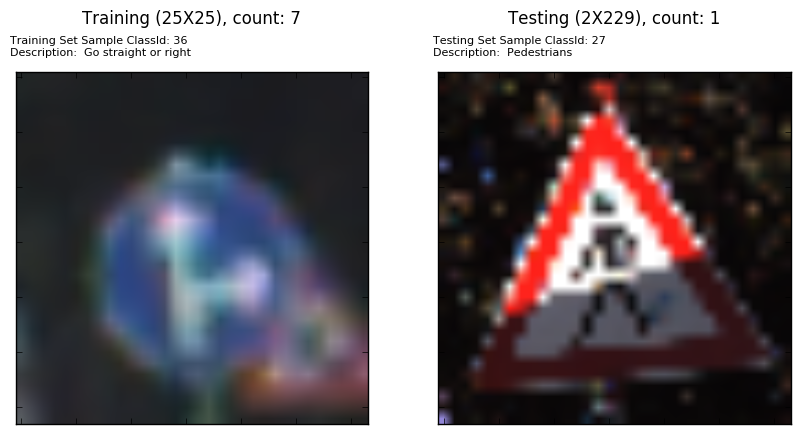

In [5]:
### Data exploration visualization goes here.
### Feel free to use as many code cells as needed.

# draw the min size pictures from both train and test
train_size = train_originalSizes[str(train_minSize)]['size']
train_count = train_originalSizes[str(train_minSize)]['count']
train_index = train_originalSizes[str(train_minSize)]['lastIdx']
train_classId = train['labels'][train_index]
train_description = classLabelList[classLabelList.ClassId==train_classId].SignName.to_string(header=False,index=False)

test_size = test_originalSizes[str(test_minSize)]['size']
test_count = test_originalSizes[str(test_minSize)]['count']
test_index = test_originalSizes[str(test_minSize)]['lastIdx']
test_classId = test['labels'][test_index]
test_description = classLabelList[classLabelList.ClassId==test_classId].SignName.to_string(header=False,index=False)

# draw the min size picture for training and testing
print("  Minimum Original Size Samples:")
fg, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 10))

ax1.imshow(X_train[train_index])
ax1.set_title('Training (%dX%d), count: %d\n\n'%(train_size[0], train_size[1], train_count))
ax1.text(-1.0,-2.0,'Training Set Sample ClassId: %d\nDescription:  %s'%(train_classId, train_description), fontsize=8)

ax2.imshow(X_test[test_index])
ax2.set_title('Testing (%dX%d), count: %d\n\n'%(test_size[0], test_size[1], test_count))
ax2.text(-1.0,-2.0,'Testing Set Sample ClassId: %d\nDescription:  %s'%(test_classId, test_description), fontsize=8)

plt.setp([a.get_xticklabels() for a in fg.axes], visible=False)
plt.setp([a.get_yticklabels() for a in fg.axes], visible=False)

plt.show()

  Maximum Original Size Samples:


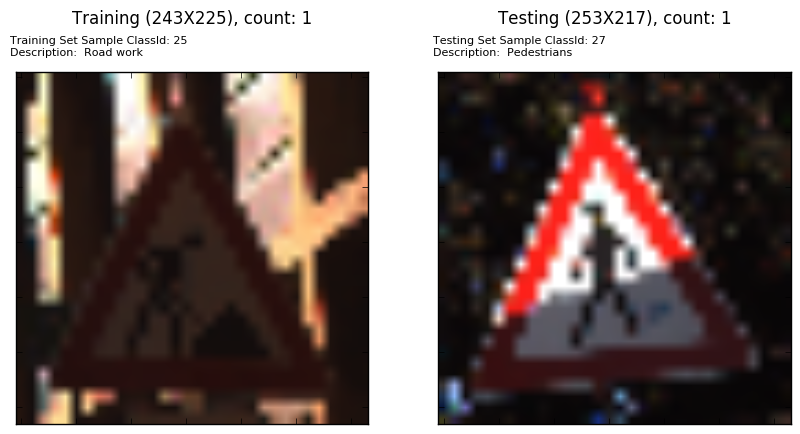

In [6]:
### Data exploration visualization goes here.
### Feel free to use as many code cells as needed.

# draw the max size pictures from both train and test
train_size = train_originalSizes[str(train_maxSize)]['size']
train_count = train_originalSizes[str(train_maxSize)]['count']
train_index = train_originalSizes[str(train_maxSize)]['lastIdx']
train_classId = train['labels'][train_index]
train_description = classLabelList[classLabelList.ClassId==train_classId].SignName.to_string(header=False,index=False)

test_size = test_originalSizes[str(test_maxSize)]['size']
test_count = test_originalSizes[str(test_maxSize)]['count']
test_index = test_originalSizes[str(test_maxSize)]['lastIdx']
test_classId = test['labels'][test_index]
test_description = classLabelList[classLabelList.ClassId==test_classId].SignName.to_string(header=False,index=False)

# draw the max size picture for training and testing
print("  Maximum Original Size Samples:")
fg, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 10))

ax1.imshow(X_train[train_index])
ax1.set_title('Training (%dX%d), count: %d\n\n'%(train_size[0], train_size[1], train_count))
ax1.text(-1.0,-2.0,'Training Set Sample ClassId: %d\nDescription:  %s'%(train_classId, train_description), fontsize=8)

ax2.imshow(X_test[test_index])
ax2.set_title('Testing (%dX%d), count: %d\n\n'%(test_size[0], test_size[1], test_count))
ax2.text(-1.0,-2.0,'Testing Set Sample ClassId: %d\nDescription:  %s'%(test_classId, test_description), fontsize=8)

plt.setp([a.get_xticklabels() for a in fg.axes], visible=False)
plt.setp([a.get_yticklabels() for a in fg.axes], visible=False)

plt.show()

  Highest Count Original Size Samples:


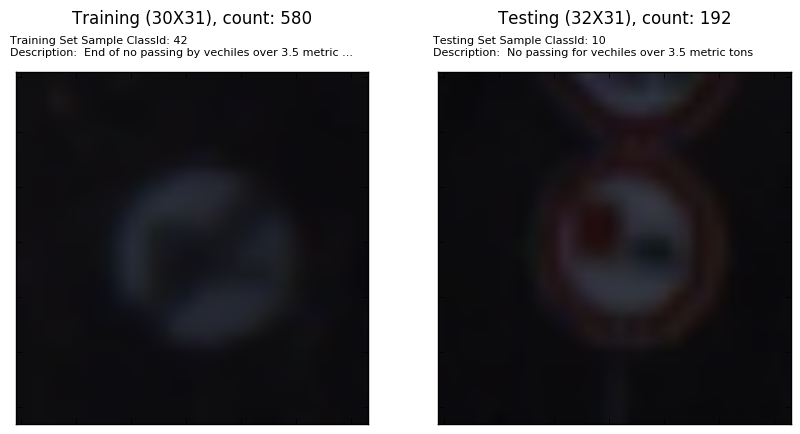

In [7]:
### Data exploration visualization goes here.
### Feel free to use as many code cells as needed.

# draw the mode size pictures from both train and test
train_size = train_originalSizes[str(train_modeSize)]['size']
train_count = train_originalSizes[str(train_modeSize)]['count']
train_index = train_originalSizes[str(train_modeSize)]['lastIdx']
train_classId = train['labels'][train_index]
train_description = classLabelList[classLabelList.ClassId==train_classId].SignName.to_string(header=False,index=False)

test_size = test_originalSizes[str(test_modeSize)]['size']
test_count = test_originalSizes[str(test_modeSize)]['count']
test_index = test_originalSizes[str(test_modeSize)]['lastIdx']
test_classId = test['labels'][test_index]
test_description = classLabelList[classLabelList.ClassId==test_classId].SignName.to_string(header=False,index=False)

# draw the mode size picture for training and testing
print("  Highest Count Original Size Samples:")
fg, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 10))

ax1.imshow(X_train[train_index])
ax1.set_title('Training (%dX%d), count: %d\n\n'%(train_size[0], train_size[1], train_count))
ax1.text(-1.0,-2.0,'Training Set Sample ClassId: %d\nDescription:  %s'%(train_classId, train_description), fontsize=8)

ax2.imshow(X_test[test_index])
ax2.set_title('Testing (%dX%d), count: %d\n\n'%(test_size[0], test_size[1], test_count))
ax2.text(-1.0,-2.0,'Testing Set Sample ClassId: %d\nDescription:  %s'%(test_classId, test_description), fontsize=8)

plt.setp([a.get_xticklabels() for a in fg.axes], visible=False)
plt.setp([a.get_yticklabels() for a in fg.axes], visible=False)

plt.show()

In [8]:
### Data exploration visualization goes here.
### Feel free to use as many code cells as needed.

def labelset_info(labelsettxt, dataset):
    # get stats for the labels
    labelset = dataset['labels']
    labelStats = pd.DataFrame(labelset)
   
    print(labelsettxt, "set label stats:")
    print(labelStats.describe())
   
    labelsInfo = {}
    modeCount = 0
    modeLabel = 0
    for i in range(len(labelset)):
        # for each label
        label = str(labelset[i])
      
        # try to see if there is a hash hit
        labelInstance = labelsInfo.get(label, {'count': 0, 'samples':[]})
      
        # add to the count
        count = labelInstance['count'] + 1
      
        # add to samples
        samples = labelInstance['samples']
        samples.append(i)
    
      # put in the last Index
        labelsInfo[label] = {'lastIdx':i, 'count': count, 'label':int(label), 'samples':samples}
      
        # update most common size
        if count > modeCount:
            modeCount = count 
            modeSize = labelsInfo[label]
    
    # get the list of counts and sort them
    sortedLabels = list(labelsInfo.keys())
   
    def compare_count(label):
        return labelsInfo[label]['count']
   
    sortedLabels.sort(key=compare_count)

    # get the unique number of original picture sizes and the min and max last instance
    n_labels = len(sortedLabels)
    minLabel = sortedLabels[0]
    maxLabel = sortedLabels[n_labels-1]

    # print the stats
    print("\nNumber of unique labels in", labelsettxt,"set: ", n_labels)

    print("\nDistribution of", labelsettxt, "set labels:")
    for n in range(n_labels):
        i = sortedLabels[n_labels-n-1]
        classId = labelsInfo[str(i)]['label']
        index = labelsInfo[str(i)]['lastIdx']
        count = labelsInfo[str(i)]['count']
        description = classLabelList[classLabelList.ClassId==classId].SignName.to_string(header=False,index=False)
        print(labelsettxt, " set count: {0:4d}  ClassId: {1:02d}  Description: {2}".format(count, classId, description))

    return n_labels, sortedLabels, labelsInfo, minLabel, maxLabel, modeLabel

train_labels, train_sortedLabels, train_labelInfo, train_minLabel, train_maxLabel, train_modeLabel = labelset_info("training", train)
test_labels, test_sortedLabels, test_labelInfo, test_minLabel, test_maxLabel, test_modeLabel = labelset_info("testing", test)


training set label stats:
                  0
count  39209.000000
mean      15.788390
std       12.013238
min        0.000000
25%        5.000000
50%       12.000000
75%       25.000000
max       42.000000

Number of unique labels in training set:  43

Distribution of training set labels:
training  set count: 2250  ClassId: 02  Description: Speed limit (50km/h)
training  set count: 2220  ClassId: 01  Description: Speed limit (30km/h)
training  set count: 2160  ClassId: 13  Description: Yield
training  set count: 2100  ClassId: 12  Description: Priority road
training  set count: 2070  ClassId: 38  Description: Keep right
training  set count: 2010  ClassId: 10  Description: No passing for vechiles over 3.5 metric tons
training  set count: 1980  ClassId: 04  Description: Speed limit (70km/h)
training  set count: 1860  ClassId: 05  Description: Speed limit (80km/h)
training  set count: 1500  ClassId: 25  Description: Road work
training  set count: 1470  ClassId: 09  Description: No passing

Train set sample images (RGB): 100%|██████████| 43/43 [00:14<00:00,  3.07labels/s]


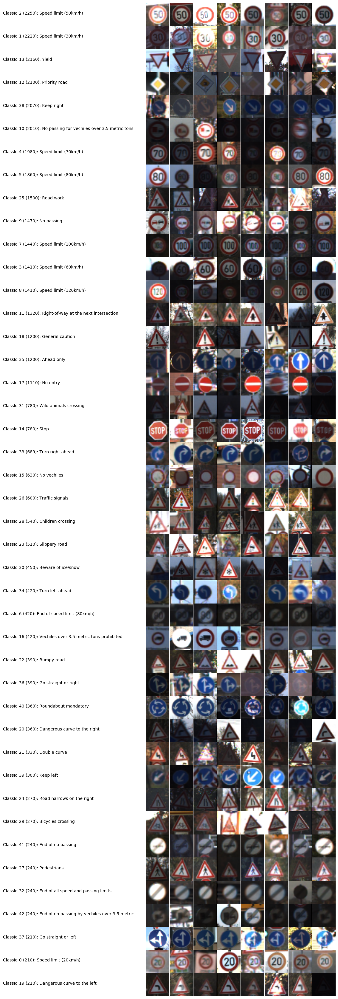

Test set sample images (RGB): 100%|██████████| 43/43 [00:15<00:00,  2.02labels/s]


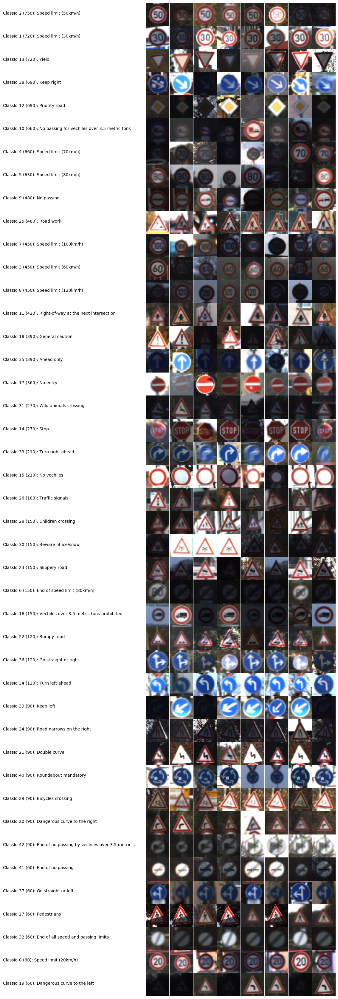

In [9]:
def draw_sample_labelsets(datasettxt, sortedlabels, labeldata, dataset, cmap=None):
    n_samples = 8
    n_labels = len(sortedlabels)
    
    # size of each sample
    fig = plt.figure(figsize=(n_samples*1.8, n_labels))
    w_ratios = [1 for n in range(n_samples)]
    w_ratios[:0] = [int(n_samples*0.8)]
    h_ratios = [1 for n in range(n_labels)]

    # gridspec
    time.sleep(1) # wait for 1 second for the previous print to appear!
    grid = gridspec.GridSpec(n_labels, n_samples+1, wspace=0.0, hspace=0.0, width_ratios=w_ratios, height_ratios=h_ratios)
    labelset_pbar = tqdm(range(n_labels), desc=datasettxt, unit='labels')
    for a in labelset_pbar:
        classId = labeldata[str(sortedlabels[n_labels-a-1])]['label']
        description = classLabelList[classLabelList.ClassId==classId].SignName.to_string(header=False,index=False)
        count = labeldata[str(sortedlabels[n_labels-a-1])]['count']
        for b in range(n_samples+1):
            i = a*(n_samples+1) + b
            ax = plt.Subplot(fig, grid[i])
            if b == 0:
                ax.annotate('ClassId %d (%d): %s'%(classId, count, description), xy=(0,0), xytext=(0.0,0.5))
                ax.set_xticks([])
                ax.set_yticks([])
                fig.add_subplot(ax)
            else:
                random_i = random.choice(labeldata[str(sortedlabels[n_labels-a-1])]['samples'])
                image = dataset[random_i]
                if cmap == None:
                    ax.imshow(image)
                else:
                    # yuv = cv2.split(image)
                    # ax.imshow(yuv[0], cmap=cmap)
                    ax.imshow(image, cmap=cmap)
                ax.set_xticks([])
                ax.set_yticks([])
                fig.add_subplot(ax)
    
        # hide the borders\
        if a == (n_labels-1):
            all_axes = fig.get_axes()
            for ax in all_axes:
                for sp in ax.spines.values():
                    sp.set_visible(False)

    plt.show()

draw_sample_labelsets('Train set sample images (RGB)', train_sortedLabels, train_labelInfo, X_train)
draw_sample_labelsets('Test set sample images (RGB)', test_sortedLabels, test_labelInfo, X_test)


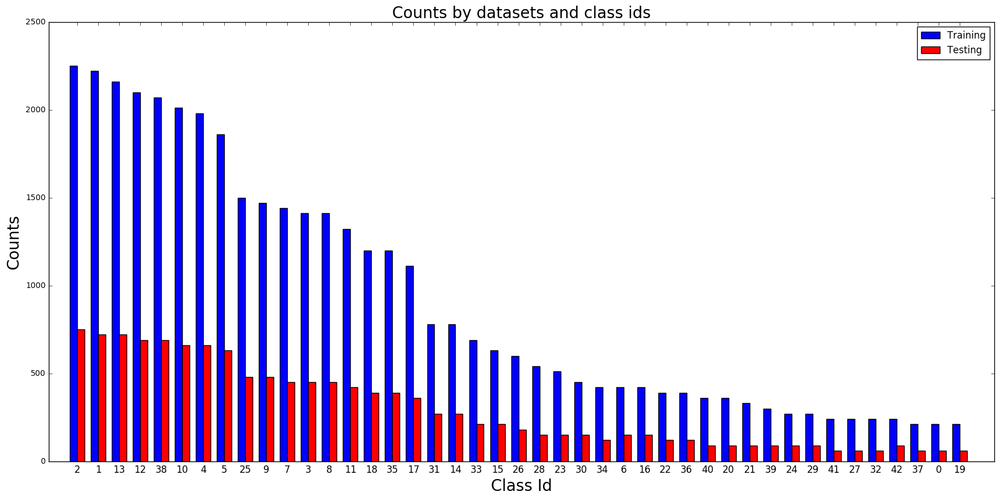

In [10]:
### Data exploration visualization goes here.
### Feel free to use as many code cells as needed.
def my_reverse(list):
    newlist = []
    for n in list:
        newlist[:0] = [n]
    return newlist

# Plot bar graph of class id count distribution
n_labels = len(train_sortedLabels)
training_labels = my_reverse(train_sortedLabels)
training_counts = [train_labelInfo[n]['count'] for n in training_labels]
testing_counts = [test_labelInfo[n]['count'] for n in training_labels]

ind = np.arange(n_labels)
width = 0.35

fg, ax = plt.subplots(figsize=(n_labels/2, 10))
rects1 = ax.bar(ind+1, training_counts, width, color='b')
rects2 = ax.bar(ind+1+width, testing_counts, width, color='r')

# add some text for labels, title and axes ticks
ax.set_ylabel("Counts", fontsize=20)
ax.set_title("Counts by datasets and class ids", fontsize=20)
ax.set_xticks(ind + width+1.0)
ax.set_xticklabels(training_labels, fontsize=12)
ax.set_xlabel("Class Id", fontsize=20)

ax.legend((rects1[0], rects2[0]), ('Training', 'Testing'))
plt.show()


In [11]:
# It seems that the 'sizes' (width, height) and 'coords' (x1, y1, x2, y2) features have the same values?
# Looks like we cannot get any real information from the 'coords' feature.
allsame = True
for i in range(n_train):
    if not (train['sizes'][i].all() == train['coords'][i].all()):
        allsame = False
if allsame:
    print("train['sizes'] == train['coords']!!!\nIgnoring 'coords' feature in train dataset.\n")

allsame = True
for i in range(n_test):
    if not (test['sizes'][i].all() == test['coords'][i].all()):
        allsame = False
if allsame:
    print("test['sizes'] == test['coords']!!!\nIgnoring 'coords' feature in test dataset.\n")



test['sizes'] == test['coords']!!!
Ignoring 'coords' feature in test dataset.



----

## Step 2: Design and Test a Model Architecture

Design and implement a deep learning model that learns to recognize traffic signs. Train and test your model on the [German Traffic Sign Dataset](http://benchmark.ini.rub.de/?section=gtsrb&subsection=dataset).

There are various aspects to consider when thinking about this problem:

- Your model can be derived from a deep feedforward net or a deep convolutional network.
- Play around preprocessing techniques (normalization, rgb to grayscale, etc)
- Number of examples per label (some have more than others).
- Generate fake data.

Here is an example of a [published baseline model on this problem](http://yann.lecun.com/exdb/publis/pdf/sermanet-ijcnn-11.pdf). It's not required to be familiar with the approach used in the paper but, it's good practice to try to read papers like these.

### Implementation

Use the code cell (or multiple code cells, if necessary) to implement the first step of your project. Once you have completed your implementation and are satisfied with the results, be sure to thoroughly answer the questions that follow.

Features are now converted YUV!


Train set sample images (YUV): 100%|██████████| 43/43 [00:15<00:00,  2.52labels/s]


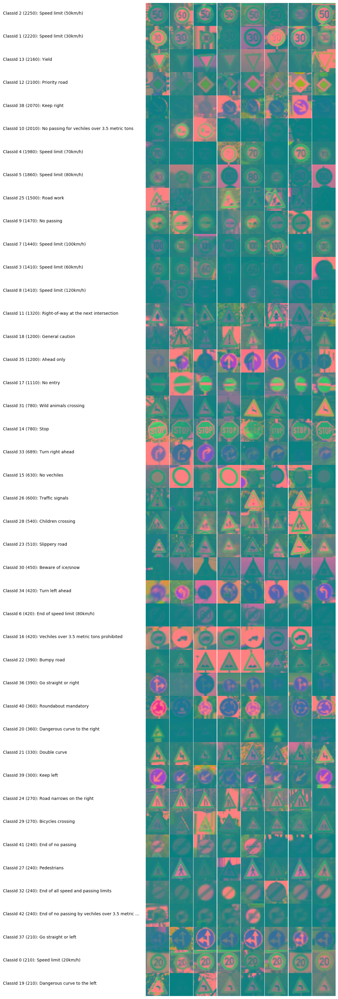

Test set sample images (YUV): 100%|██████████| 43/43 [00:15<00:00,  3.02labels/s]


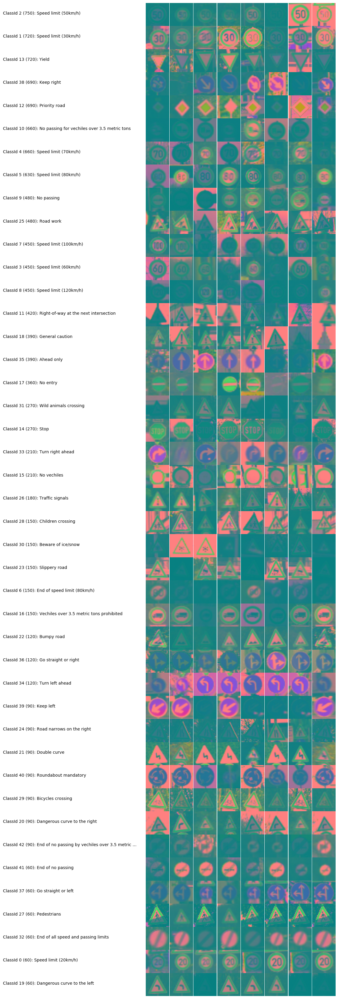

In [12]:
### Preprocess the data here.
### Feel free to use as many code cells as needed.
###
### Step 1:
### We need to condition the training and testing data.  We need to convert the color image to grey scale since
### RGB features in the traffic sign will not contribute to its classification and recognition.  We will use
### OpenCV to do the conversion as we did in the earlier Lane Line Project 1 to reduce the size of the features
### so as to allow the Stochastic Gradient Descent Machine Learning algorithm to process more relivent data to
### learn faster.  In referencing the article: http://yann.lecun.com/exdb/publis/pdf/sermanet-ijcnn-11.pdf,
### page 2, section III. EXPERIMENTS, subsection A. Data Preparation, item 2) Pre-processing, we find 
### converting the feature RGB color space to YUV seems to improve classification and recognition, and we will
### follow this path as well.  Since our training and test features are already at 32x32 resolution, we just
### need to do the conversion to YUV color space in this step.

def RGB2YUV(image_data):
    yuv_image_data = []
    for i in range(len(image_data)):
        yuv_image_data.append(cv2.cvtColor(image_data[i], cv2.COLOR_RGB2YUV))
    return np.array(yuv_image_data)

if is_features_yuv:
    print('Nothing done.  Features are already in YUV!')
else:
    X_train = RGB2YUV(X_train)
    y_train = np.copy(y_train)
    X_test = RGB2YUV(X_test)
    y_test = np.copy(y_test)
    is_features_yuv = True
    print('Features are now converted YUV!')

# draw some sample pictures.
draw_sample_labelsets('Train set sample images (YUV)', train_sortedLabels, train_labelInfo, X_train)
draw_sample_labelsets('Test set sample images (YUV)', test_sortedLabels, test_labelInfo, X_test)


Features Y are now normalized and converted to float32!


Train set sample images (Normalized Y): 100%|██████████| 43/43 [00:15<00:00,  2.85labels/s]


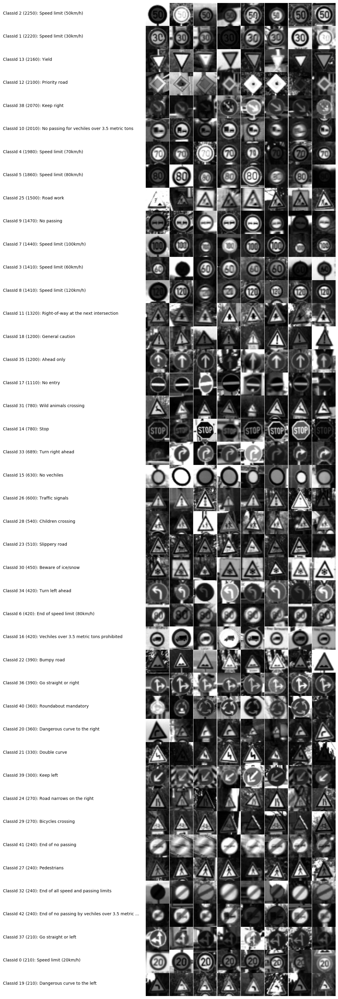

Test set sample images (Normalized Y): 100%|██████████| 43/43 [00:15<00:00,  3.23labels/s]


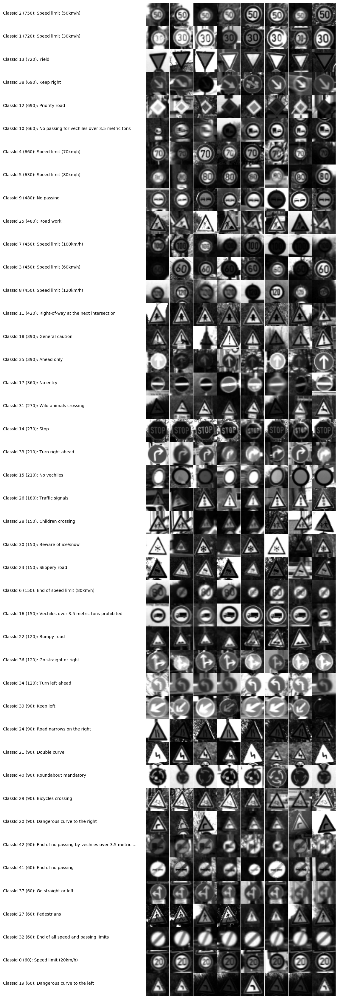

In [13]:
### Preprocess the data here.
### Feel free to use as many code cells as needed.
###
### Step 2:
### We will implement the Min-Max scaling function and apply it to the Y in the UV color space as described in
### in the article: http://yann.lecun.com/exdb/publis/pdf/sermanet-ijcnn-11.pdf, page 2, section III.
### EXPERIMENTS, subsection A. Data Preparation, item 2) Pre-processing.  We will apply this to images we
### converted in step 1.
###
### This is needed as we did in the TensorFlow Neural Network Lab assignment to process the image into a
### well conditioned features so we are centered on a zero mean with equal variance to make it easy for
### our neural network to perform Gradient Descent faster to train its weights and biases to the given labels.
### We will also convert the features from uint8 to float32 to make it easier for GPUs to process the data
### Using their thousands of multi-cores parallel processing units in a CUDA enabled Deep Learning system.

def normalize_Y_in_YUV(image_data):
    """
    Normalize the image data with Min-Max scaling to a range of [0.1, 0.9]
    :param image_data: The image data to be normalized
    :return: Normalized image data
    """
    a = 0.1
    b = 0.9
    y_min = 0
    y_max = 255
    yuv_image_data = []

    for i in range(len(image_data)):
        yuv = cv2.split(image_data[i])  
        y = np.array(yuv[0], np.float32)
        y = a + ( ( (y - y_min)*(b - a) )/( y_max - y_min ) )
        u = np.array(yuv[1], np.float32)
        v = np.array(yuv[2], np.float32)
        yuv = np.dstack((y, u, v))
        yuv_image_data.append(yuv)
    return np.array(yuv_image_data)

def normalize_Y(image_data):
    """
    Normalize the image data with Min-Max scaling to a range of [0.1, 0.9]
    :param image_data: The image data to be normalized
    :return: Normalized image data
    """
    a = 0.1
    b = 0.9
    y_min = 0
    y_max = 255
    y_image_data = []

    for i in range(len(image_data)):
        yuv = cv2.split(image_data[i])  
        y = np.array(yuv[0], np.float32)
        y = a + ( ( (y - y_min)*(b - a) )/( y_max - y_min ) )
        y_image_data.append(y)
    return np.array(y_image_data)

if is_features_y_normal:
    print('Nothing done.  Features Y are already normalized and converted to float32!')
else:
    #X_train = normalize_Y_in_YUV(X_train)
    #X_test = normalize_Y_in_YUV(X_test)
    X_train = normalize_Y(X_train)
    X_test = normalize_Y(X_test)
    is_features_y_normal = True
    print('Features Y are now normalized and converted to float32!')

# draw some sample pictures.
draw_sample_labelsets('Train set sample images (Normalized Y)', train_sortedLabels, train_labelInfo, X_train, cmap='gray')
draw_sample_labelsets('Test set sample images (Normalized Y)', test_sortedLabels, test_labelInfo, X_test, cmap='gray')


In [14]:
### Preprocess the data here.
### Feel free to use as many code cells as needed.
###
### Step 3:
### We will apply One-Hot Encoding to our numeric traffic labels.
### This is a way to represent our labels mathematically so that we have a vector that contains
### as many values as we have classes.  The value that we want to set for the correct class is set
### to 1 while all others are set to 0.  We will follow this by changing our One-Hot Encoded labels
### to float32 so as to allow them to be multiplied against the features in Tensorflow using the
### thousands of multi-cores parallel processing units in a CUDA enabled Deep Learning system.


assert is_features_y_normal

if is_labels_encod:
    print('Nothing done.  Labels are already One-Hot encoded!')
else:
    encoder = LabelBinarizer()
    encoder.fit(y_train)
    y_train_onehot = encoder.transform(y_train)
    y_test_onehot = encoder.transform(y_test)
    is_labels_encod = True
    y_train_onehot = y_train_onehot.astype(np.float32)
    y_test_onehot = y_test_onehot.astype(np.float32)
    is_labels_float32 = True
    
    # put together a onehot label table
    onehot_labels = [n for n in range(len(train_sortedLabels))]
    onehot_labels = encoder.transform(onehot_labels)
    onehot_labels = onehot_labels.astype(np.float32)

    print('Labels are now One-Hot encoded and converted to float32!')


Labels are now One-Hot encoded and converted to float32!


### Question 1 

_Describe the techniques used to preprocess the data._

**Answer:**

In [15]:
### Generate data additional (if you want to!)
### Feel free to use as many code cells as needed.
###
### In referencing the article: http://yann.lecun.com/exdb/publis/pdf/sermanet-ijcnn-11.pdf,
### page 2, section III. EXPERIMENTS, subsection A. Data Preparation, item 2) Pre-processing, we find 
### that if we generate a "Jittered dataset" and use it exclusively for training, it should drop our
### validation error from around 1.31% to 1.08%.  We can follow the same procedure as described in
### this section, and generate additional 5X samples by randomly perturbed in position ([-2,2] pixels),
### in scale ([.9,1.1] ratio) and rotation ([-15,+15] degrees).  As described in the reference:
### "When a dataset does not naturally contain those deformations, adding them synthetically will yield
### more robust learning to potential deformations in the test set."  The other reason to generate
### a new test set is that the class labels are not evenly distributed, we can generate a more evenly
### distributed set of dataset for training and leave the original set for validation.  

assert is_features_yuv
assert is_features_y_normal
assert is_labels_encod
assert is_labels_float32

### Data exploration visualization goes here.
### Feel free to use as many code cells as needed.

def labelset2_info(labelsettxt, labelset):
    # get stats for the labels
    labelStats = pd.DataFrame(labelset)
   
    print(labelsettxt, "set label stats:")
    print(labelStats.describe())
   
    labelsInfo = {}
    modeCount = 0
    modeLabel = 0
    for i in range(len(labelset)):
        # for each label
        label = str(labelset[i])
      
        # try to see if there is a hash hit
        labelInstance = labelsInfo.get(label, {'count': 0, 'samples':[]})
      
        # add to the count
        count = labelInstance['count'] + 1
      
        # add to samples if less than 8
        samples = labelInstance['samples']
        if len(samples) < 8:
            samples.append(i)
    
      # put in the last Index
        labelsInfo[label] = {'lastIdx':i, 'count': count, 'label':int(label), 'samples':samples}
      
        # update most common size
        if count > modeCount:
            modeCount = count 
            modeSize = labelsInfo[label]
    
    # get the list of counts and sort them
    sortedLabels = list(labelsInfo.keys())
   
    def compare_count(label):
        return labelsInfo[label]['count']
   
    sortedLabels.sort(key=compare_count)

    # get the unique number of original picture sizes and the min and max last instance
    n_labels = len(sortedLabels)
    minLabel = sortedLabels[0]
    maxLabel = sortedLabels[n_labels-1]

    # print the stats
    print("\nNumber of unique labels in", labelsettxt,"set: ", n_labels)

    print("\nDistribution of", labelsettxt, "set labels:")
    for n in range(n_labels):
        i = sortedLabels[n_labels-n-1]
        classId = labelsInfo[str(i)]['label']
        index = labelsInfo[str(i)]['lastIdx']
        count = labelsInfo[str(i)]['count']
        description = classLabelList[classLabelList.ClassId==classId].SignName.to_string(header=False,index=False)
        print(labelsettxt, " set count: {0:4d}  ClassId: {1:02d}  Description: {2}".format(count, classId, description))

    return n_labels, sortedLabels, labelsInfo, minLabel, maxLabel, modeLabel

# move our original training dataset for validation 
X_valid = X_train
y_valid = y_train
y_valid_onehot = y_train_onehot
old_y_test_labels = np.append(test['labels'], train['labels'], axis=0)

# make sure we don't use our previous training data.
X_train = []
y_train = []
y_train_onehot = []

print("Original training set is now the validation set.")

Original training set is now the validation set.


In [16]:
### After thinking this over, we believe generating this additional dataset now, is not appropriate
### after all, what would be better is to generate this needed training data on the fly in batches
### when required by then training.  The following are just functions for doing the generation based
### on already collected data about the label distribution from the last section.  We will now combine
### the current training and testing set into one for testing, and generate our training and validation
### sets on the fly.
###
### set up our training and validating dataset/batch generator.

# function to shift images x or y offsets
def shiftxy(image, xoffset, yoffset):
    rows,cols, depth = image.shape
    M = np.float32([[1,0,xoffset],[0,1,yoffset]])
    res = cv2.warpAffine(np.copy(image),M,(cols,rows))
    assert (res.shape[0] == 32)
    assert (res.shape[1] == 32)
    return res
    
# function to rotate images by given degrees
def rotate(image, degree):
    rows, cols, depth = image.shape
    M = cv2.getRotationMatrix2D((cols/2,rows/2), degree, 1)
    res = cv2.warpAffine(image, M, (cols,rows))
    assert (res.shape[0] == 32)
    assert (res.shape[1] == 32)
    return res
    
# function to resize the image
def scale(image, ratio):
    rows, cols, depth = image.shape
    newrows = int(ratio*rows)
    newcols = int(ratio*cols)
    res = cv2.resize(image, (newrows, newcols), interpolation=cv2.INTER_AREA)
    if newrows*newcols > 1024:
        # image is larger than 32x32, randomly crop the image back to 32x32
        xoffset = (newcols-32)-int(random.random()*float(newcols-32))
        yoffset = (newrows-32)-int(random.random()*float(newrows-32))
        cropped = res[xoffset:xoffset+32, yoffset:yoffset+32]
        res = cropped
    else:
        # image is smaller than before, randomly insert it into a 32x32 canvas
        if newrows*newcols < 1024:
            tmpimage = np.copy(image)*0
            xoffset = (32-newcols)-int(random.random()*float(32-newcols))
            yoffset = (32-newrows)-int(random.random()*float(32-newrows))
            tmpimage[xoffset:newrows+xoffset, yoffset:newcols+yoffset] = res
            res = tmpimage
    assert (res.shape[0] == 32)
    assert (res.shape[1] == 32)
    return res

def gaussian_blur(img, kernel_size):
    # Applies a Gaussian Noise kernel
    return cv2.GaussianBlur(img, (kernel_size, kernel_size), 0)

def intensity(image, factor):
    maxIntensity = 255.0 # depends on dtype of image data
    phi = 1
    theta = 1
    image0 = (maxIntensity/phi)*(image/(maxIntensity/theta))**factor
    return np.array(image0, dtype=np.uint8)

def jitterA(simage):
    # set up the random jitter
    x = int(random.random() * 6) - 3
    y = int(random.random() * 6) - 3
    degree = int(random.random()*30.0)-15
    ratio = random.random()*0.3 + 0.85
    brightness = (random.random()*1.5)+0.5
    
    image = intensity(scale(rotate(shiftxy(simage,x,y),degree),ratio), brightness)
    return image

def jitterB(simage):
    # set up the random jitter
    x = int(random.random() * 12) - 6
    y = int(random.random() * 6) - 3
    degree = int(random.random()*30.0)-15
    ratio = random.random()*0.4 + 0.80
    kernel_size = int(random.random()*3)*2+1
    
    image = scale(rotate(shiftxy(simage,x,y),degree),ratio)
    return image

def jitterC(simage):
    # set up the random jitter
    x = int(random.random() * 4) - 2
    y = int(random.random() * 4) - 2
    degree = int(random.random()*30.0)-15
    ratio = random.random()*0.2 + 0.9
    
    image = scale(rotate(shiftxy(simage,x,y),degree),ratio)
    return image

def jitterD(simage):
    # set up the random jitter
    x = int(random.random() * 4) - 2
    y = int(random.random() * 4) - 2
    degree = int(random.random()*30.0)-15
    ratio = random.random()*0.4 + 0.8
    kernel_size = int(random.random()*2)
    brightness = (random.random()*1.5)+0.5
    if kernel_size == 0:
        image = intensity(scale(rotate(shiftxy(simage,x,y),degree),ratio),brightness)
    else:
        kernel_size = 3
        image = gaussian_blur(intensity(scale(rotate(shiftxy(simage,x,y),degree),ratio), brightness), kernel_size)
    return image

def jitterE(simage):
    # set up the random jitter
    x = int(random.random() * 6) - 3
    y = int(random.random() * 12) - 6
    degree = int(random.random()*40.0)-20
    ratio = random.random()*0.3 + 0.85
    brightness = (random.random()*1.5)+0.5
    
    image = intensity(scale(rotate(shiftxy(simage,x,y),degree),ratio),brightness)
    return image


def next_batch(batch_size, jitter=[jitterA, jitterB, jitterC, jitterD, jitterE]):
    sortedlabels = [train_sortedLabels]
    sourcefeatureset = [train]
    sourcelabelset = [train_labelInfo]
    tmp_y_labelset = []
    tmp_y_onehot = []
    tmp_x_featureset = []
    for i in range(batch_size):
        source = 0
        sfeature = sourcefeatureset[source]
        slabel = sourcelabelset[source]

        # get a random label
        n_labels = len(slabel)
        classNum = int(random.random()*n_labels)

        # get a random index from the random source of that random label
        rindex = int(random.random() * len(slabel[str(classNum)]['samples']))
        sindex = slabel[str(classNum)]['samples'][rindex]
        simage = sfeature['features'][sindex]
        
        tmp_y_labelset.append(classNum)
        tmp_y_onehot.append(onehot_labels[classNum])
        jitterRoutine = int(random.random()*len(jitter))
        tmp_x_featureset.append(jitter[jitterRoutine](simage))


    # return normalize_Y_in_YUV(RGB2YUV(tmp_x_featureset)), tmp_y_labelset, tmp_y_onehot
    return normalize_Y(RGB2YUV(tmp_x_featureset)), tmp_y_labelset, tmp_y_onehot

### generate a training set
def generate_batch(epochs, batch_size, jitters=[jitterA, jitterB, jitterC, jitterD, jitterE]):
    newbatchsize = epochs*batch_size
    return next_batch(newbatchsize, jitters)

def generate_batch_with_pbar(epochs, batch_size, jitters=[jitterA, jitterB, jitterC, jitterD, jitterE]):
    X = []
    y = []
    y_onehot = []

    batches_pbar = tqdm(range(epochs), desc='Generating Training', unit='batches')
    for b in batches_pbar:
        X_trainX, y_trainX, y_trainX_onehot = next_batch(batch_size, jitters)
        X[:0] = X_trainX
        y[:0] = y_trainX
        y_onehot[:0] = y_trainX_onehot
    return X, y, y_onehot

epochs = 20
batch_size = 10000
X_train2, y_train2, y_train2_onehot = generate_batch_with_pbar(epochs, batch_size)
    
# show the stats
train2_labels, train2_sortedLabels, train2_labelInfo, train2_minLabel, train2_maxLabel, train2_modeLabel = labelset2_info("training", y_train2)
valid2_labels, valid2_sortedLabels, valid2_labelInfo, valid2_minLabel, valid2_maxLabel, valid2_modeLabel = labelset2_info("validation", y_valid)
test2_labels, test2_sortedLabels, test2_labelInfo, test2_minLabel, test2_maxLabel, test2_modeLabel = labelset2_info("testing", y_test)


Generating Training: 100%|██████████| 20/20 [00:37<00:00,  1.87s/batches]


training set label stats:
                   0
count  200000.000000
mean       21.013815
std        12.387744
min         0.000000
25%        10.000000
50%        21.000000
75%        32.000000
max        42.000000

Number of unique labels in training set:  43

Distribution of training set labels:
training  set count: 4823  ClassId: 23  Description: Slippery road
training  set count: 4789  ClassId: 20  Description: Dangerous curve to the right
training  set count: 4776  ClassId: 10  Description: No passing for vechiles over 3.5 metric tons
training  set count: 4748  ClassId: 30  Description: Beware of ice/snow
training  set count: 4732  ClassId: 35  Description: Ahead only
training  set count: 4723  ClassId: 22  Description: Bumpy road
training  set count: 4720  ClassId: 27  Description: Pedestrians
training  set count: 4713  ClassId: 05  Description: Speed limit (80km/h)
training  set count: 4708  ClassId: 25  Description: Road work
training  set count: 4704  ClassId: 42  Description:

Generated Train set sample images (Normalized Y): 100%|██████████| 43/43 [00:15<00:00,  2.82labels/s]


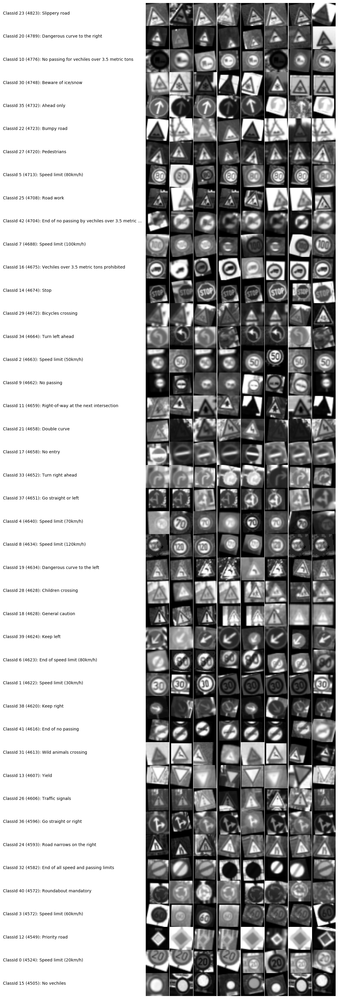

Original Train as Validate set sample images (Normalized Y): 100%|██████████| 43/43 [00:15<00:00,  2.03labels/s]


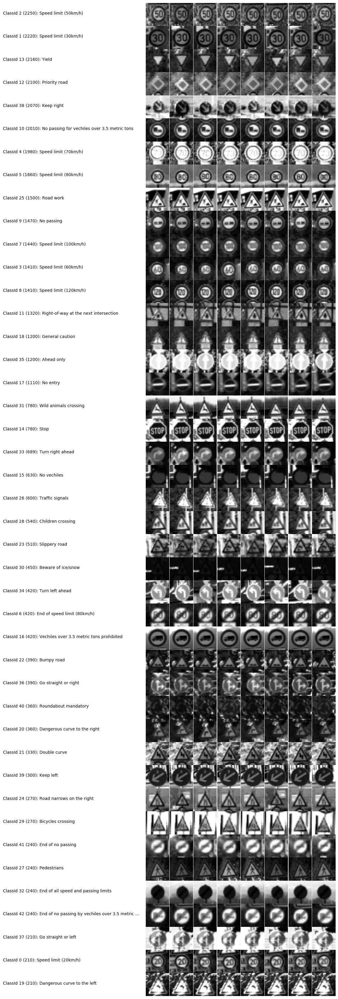

Test set sample images (Normalized Y): 100%|██████████| 43/43 [00:15<00:00,  2.31labels/s]


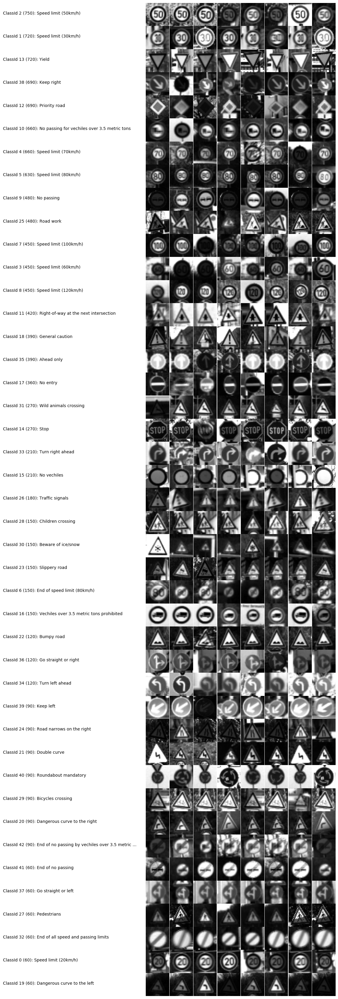

In [17]:
### Generate data additional (if you want to!)
### Visualize the new Jittered Dataset
### get stats for the labels

# draw some sample pictures.
draw_sample_labelsets('Generated Train set sample images (Normalized Y)', train2_sortedLabels, train2_labelInfo, X_train2, cmap='gray')
draw_sample_labelsets('Original Train as Validate set sample images (Normalized Y)', valid2_sortedLabels, valid2_labelInfo, X_valid, cmap='gray')
draw_sample_labelsets('Test set sample images (Normalized Y)', test2_sortedLabels, test2_labelInfo, X_test, cmap='gray')


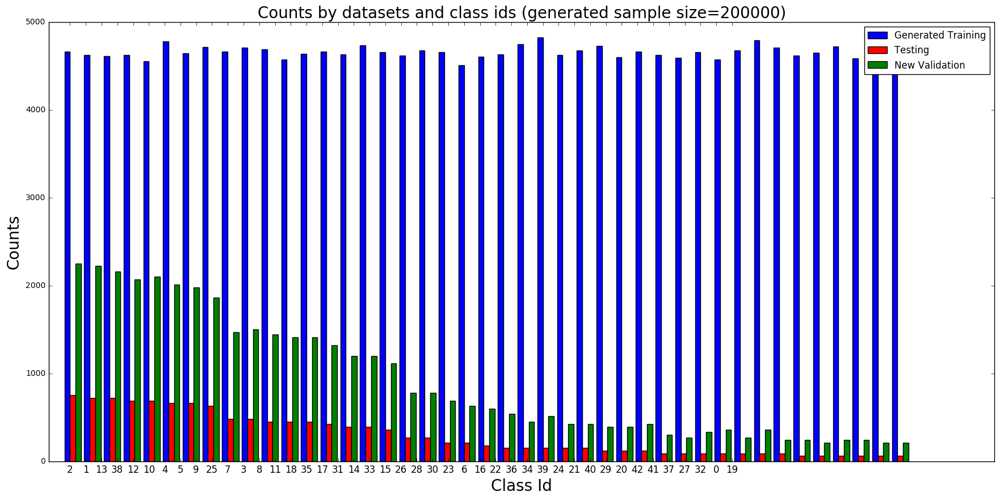

In [18]:
### Generate data additional (if you want to!)
# Plot bar graph of class id count distribution with the additional jittered dataset via batch sample

# Plot bar graph of new class id count distribution
n_labels = len(train2_sortedLabels)
training_labels = my_reverse(test2_sortedLabels)
training_counts = [train2_labelInfo[n]['count'] for n in training_labels]
validating_counts = [valid2_labelInfo[n]['count'] for n in training_labels]
testing_counts = [test2_labelInfo[n]['count'] for n in training_labels]

ind = np.arange(n_labels)
width = 0.35

fg, ax = plt.subplots(figsize=(n_labels/2, 10))
rects1 = ax.bar(ind*1.25+1.0, training_counts, width, color='b')
rects2 = ax.bar(ind*1.25+1.0+width, testing_counts, width, color='r')
rects3 = ax.bar(ind*1.25+1.0+width*2, validating_counts, width, color='g')

# add some text for labels, title and axes ticks
ax.set_ylabel("Counts", fontsize=20)
ax.set_title("Counts by datasets and class ids (generated sample size=%d)"%(sum(training_counts)), fontsize=20)
ax.set_xticks(ind + width+1.0)
ax.set_xticklabels(training_labels, fontsize=12)
ax.set_xlabel("Class Id", fontsize=20)

ax.legend((rects1[0], rects2[0], rects3), ('Generated Training', 'Testing', 'New Validation'))
plt.show()


In [19]:
### Split the data into training/validation/testing sets here.
### Feel free to use as many code cells as needed.
###
### No Need - the next_batch automatically randomized the training and validation sets

### Define next batch for validate
def next_train(index, batch_size):
    batch_count = int(math.ceil(len(y_train2)/batch_size))
    current_batch = index % batch_count
    # print("batch_size: ", batch_size, "batch_count: ", batch_count, "current_batch: ", current_batch)
    batch_start = current_batch*batch_size
    batch_images = X_train2[batch_start:batch_start + batch_size]
    batch_labels = y_train2_onehot[batch_start:batch_start + batch_size]
    return (batch_images, batch_labels)

def next_validate(index, batch_size):
    batch_count = int(math.ceil(len(y_valid)/batch_size))
    current_batch = index % batch_count
    # print("batch_size: ", batch_size, "batch_count: ", batch_count, "current_batch: ", current_batch)
    batch_start = current_batch*batch_size
    batch_images = X_valid[batch_start:batch_start + batch_size]
    batch_labels = y_valid_onehot[batch_start:batch_start + batch_size]
    return (batch_images, batch_labels)

print('No Need - The next_batch automatically randomized the training sets!')
print('          The new generated dataset will be fetched in batches with correct labels!')
print('          We will use the entire original training set as the validation set')


No Need - The next_batch automatically randomized the training sets!
          The new generated dataset will be fetched in batches with correct labels!
          We will use the entire original training set as the validation set


### Question 2

_Describe how you set up the training, validation and testing data for your model. If you generated additional data, why?_

**Answer:**

In [1]:
### Define your architecture here.
### Feel free to use as many code cells as needed.
###
### VERSION 1:  This is a straight forward 2 layer Convolution Model.
###             We were able to achieve 0.9544739723205566 testing accuracy using this model.
### Based on:
###    https://www.tensorflow.org/versions/r0.11/tutorials/mnist/pros/index.html
### deep multi-layer convolutional networks or (ConvNets) are great at classifying
### pictures of traffic signs and other picture recognition, such as pictures from the MNIST database.
### In particular, www.tensorflow.org has examples and tutorials on how to set up such a network for
### performing just this classification.  We will start with their example and use some of the insights
### gleamed from the yann.lecum.com article to set up our initial architecture.
### Since we are in a Jupyter interactive session, we will follow the www.tensorflow.com's MNIST PRO
### tutorial and use an InteractiveSession to access the and build a computation graph as we build our
### ConvNet for traffic sign classification and recognition.

# set up tensorflow
import tensorflow as tf

# define our new weighs and bias variables functions.
# we need to initialize the weights with a small amount of noise for symmetry
# breaking, and to prevent 0 gradients.
def weight_variable(shape):
  initial = tf.truncated_normal(shape, stddev=0.1)
  return tf.Variable(initial)

# Since we are using ReLU neurons, it is also good practice to initialize them
# with a slightly positive initial bias to avoid "dead neurons".
def bias_variable(shape):
  initial = tf.constant(0.1, shape=shape)
  return tf.Variable(initial)

# define our conv2d and max_pool functions
# vanilla version conv2d - stride of one and zero padded
def conv2d(x, W):
  return tf.nn.conv2d(x, W, strides=[1, 1, 1, 1], padding='SAME')

# plain old max pooling over 2x2 blocks
def max_pool_2x2(x):
  return tf.nn.max_pool(x, ksize=[1, 2, 2, 1],
                        strides=[1, 2, 2, 1], padding='SAME')

# first convolution layer: our vanilla conv2d followed by max_pooling.
W_conv1 = weight_variable([5, 5, 1, 32])
b_conv1 = bias_variable([32])

# we will reshape our image from 32x32 to a 4d tensor, with the second and
# third dimensions corresponding to the image width and height and the final
# dimension corresponding to the number of color channel - 1 in our case.

x_image = tf.placeholder(tf.float32, [None, 32,32,1])

# we then convolute x_image with the weight tensor and add the bias, our good old:
#    y = Wx + b
# apply the ReLU function then follow that by sending the result into our
# max_pooling over 2x2 blocks
h_conv1 = tf.nn.relu(conv2d(x_image, W_conv1) + b_conv1)
h_pool1 = max_pool_2x2(h_conv1)

# we then stack another convolution layer on top of this with 64 features
# for each 5 x 5 patch.
W_conv2 = weight_variable([5, 5, 32, 64])
b_conv2 = bias_variable([64])

# again we convolute the max pooling over 2x2 block result from the previous
# layer with the layer 2 weight tensor and layer 2 bias, another version of our
# good old:
#    y = Wx + b
# apply the ReLU function then follow that by sending the result into another
# max_pooling over 2x2 blocks
h_conv2 = tf.nn.relu(conv2d(h_pool1, W_conv2) + b_conv2)
h_pool2 = max_pool_2x2(h_conv2)

# we then send this into a densely (fully) connected network
# Our image is now just 8 x 8 of 64 features each.  We will send them into a
# fully connected layer with 1024 neurons to allow processing on the entire image.
W_fc1 = weight_variable([8*8*64, 1024])
b_fc1 = bias_variable([1024])

# We will reshape the tensor from the pooling layer into a batch of ventors,
# multiply by weight matrix, add bias and apply ReLU as before.
h_pool2_flat = tf.reshape(h_pool2, [-1, 8*8*64])
h_fc1 = tf.nn.relu(tf.matmul(h_pool2_flat, W_fc1) + b_fc1)

# We will add dropout function into the model to reduce overfitting by dropping
# out partial predictions that do not meet our threshold during training.
# This will allow us to turn it back on during testing so as to ensure we are
# predicting properly.
keep_prob = tf.placeholder(tf.float32)
h_fc1_drop = tf.nn.dropout(h_fc1, keep_prob)

# Finally our fully connected layer will be terminated to another fully connected
# layer of 1024 softmax regression functions.
W_fc2 = weight_variable([1024, 43])
b_fc2 = bias_variable([43])

# good old y = Wx + b again
y_conv = tf.matmul(h_fc1_drop, W_fc2) + b_fc2

# Define loss and optimizer
y_ = tf.placeholder(tf.float32, [None, 43])

#
#   tf.reduce_mean(-tf.reduce_sum(y_ * tf.log(tf.softmax(y)),
#                                 reduction_indices=[1]))
#
# can be numerically unstable.
#
# So here we use tf.nn.softmax_cross_entropy_with_logits on the raw
# outputs of 'y', and then average across the batch.

def setup_model_parameters(learning_rate):
    cross_entropy = tf.reduce_mean(tf.nn.softmax_cross_entropy_with_logits(y_conv, y_))
    train_step = tf.train.AdamOptimizer(learning_rate).minimize(cross_entropy)

    # Define test model prediction and accuracy functions
    correct_prediction = tf.equal(tf.argmax(y_conv,1), tf.argmax(y_,1))
    accuracy = tf.reduce_mean(tf.cast(correct_prediction, tf.float32))
    
    return cross_entropy, train_step, correct_prediction, accuracy

print("ConvNet Model for image classification has been defined")


ConvNet Model for image classification has been defined


In [2]:
### Define your architecture here.
### Feel free to use as many code cells as needed.
###
### VERSION 2:  This is a simple Convolution Model with an inception module.
###             We were able to achieve 0.9703092575073242 testing accuracy using this model.
###
### We will build a deep mult-layer, multi-scaled convolutional network.  Based on both:
###    1. http://yann.lecun.com/exdb/publis/pdf/sermanet-ijcnn-11.pdf
###    2. https://www.tensorflow.org/versions/r0.11/tutorials/mnist/pros/index.html
### deep multi-layer, multi-scaled convolutional networks or (ConvNets) are great at classifying
### pictures of traffic signs and other picture recognition, such as pictures from the MNIST database.
### In particular, www.tensorflow.org has examples and tutorials on how to set up such a network for
### performing just this classification.  We will start with their example and use some of the insights
### gleamed from the yann.lecum.com article to set up our initial architecture.
### Since we are in a Jupyter interactive session, we will follow the www.tensorflow.com's MNIST PRO
### tutorial and use an InteractiveSession to access the and build a computation graph as we build our
### ConvNet for traffic sign classification and recognition.

# set up tensorflow
import tensorflow as tf

# define our new weighs and bias variables functions.
# we need to initialize the weights with a small amount of noise for symmetry
# breaking, and to prevent 0 gradients.
def weight_variable(shape):
  initial = tf.truncated_normal(shape, stddev=0.1)
  return tf.Variable(initial)

# Since we are using ReLU neurons, it is also good practice to initialize them
# with a slightly positive initial bias to avoid "dead neurons".
def bias_variable(shape):
  initial = tf.constant(0.1, shape=shape)
  return tf.Variable(initial)

# define our conv2d and max_pool functions
# vanilla version conv2d - stride of one and zero padded
def conv2d(x, W):
  return tf.nn.conv2d(x, W, strides=[1, 1, 1, 1], padding='SAME')

# plain old max pooling over 2x2 blocks
def max_pool_2x2(x):
  return tf.nn.max_pool(x, ksize=[1, 2, 2, 1],
                        strides=[1, 2, 2, 1], padding='SAME')

# normalize
def norm(x):
    return tf.nn.lrn(x, 4, bias=1.0, alpha=0.001/9.00, beta=0.75)

# first convolution layer: our vanilla conv2d followed by max_pooling.
#W_conv1 = weight_variable([5, 5, 3, 32])
W_conv1 = weight_variable([5, 5, 1, 32])
b_conv1 = bias_variable([32])

# we will reshape our image from 32x32x3 to a 4d tensor, with the second and
# third dimensions corresponding to the image width and height and the final
# dimension corresponding to the number of color channel - 1 in our case.

# x_image = tf.placeholder(tf.float32, [None, 32,32,1])
x = tf.placeholder(tf.float32, [None, 32, 32])
x_image = tf.reshape(x, [-1,32,32,1])

# we then convolute x_image with the weight tensor and add the bias, our good old:
#    y = Wx + b
# apply the ReLU function then follow that by sending the result into our
# max_pooling over 2x2 blocks
h_conv1 = tf.nn.relu(conv2d(x_image, W_conv1) + b_conv1)
h_pool1 = max_pool_2x2(h_conv1)
h_norm1 = norm(h_pool1)

# we then stack another convolution layer on top of this with 64 features
# for each 5 x 5 patch.
W_conv2 = weight_variable([5, 5, 32, 64])
b_conv2 = bias_variable([64])

# again we convolute the max pooling over 2x2 block result from the previous
# layer with the layer 2 weight tensor and layer 2 bias, another version of our
# good old:
#    y = Wx + b
# apply the ReLU function then follow that by sending the result into another
# max_pooling over 2x2 blocks
h_conv2 = tf.nn.relu(conv2d(h_norm1, W_conv2) + b_conv2)
h_norm2 = norm(h_conv2)
h_pool2 = max_pool_2x2(h_norm2)

# we then convolute stack of 8x8x64 with the weight tensor and add the bias, our good old:
#    y = Wx + b
# apply the ReLU function then follow that by sending the result into our
# max_pooling over 2x2 blocks

# we then stack another convolution layer on top of this with 128 features
# for each 3 x 3 patch.
W_conv3 = weight_variable([3, 3, 64, 128])
b_conv3 = bias_variable([128])

# again we convolute the max pooling over 2x2 block result from the previous
# layer with the layer 2 weight tensor and layer 2 bias, another version of our
# good old:
#    y = Wx + b
# apply the ReLU function then follow that by sending the result into another
# max_pooling over 2x2 blocks
h_conv3 = tf.nn.relu(conv2d(h_pool2, W_conv3) + b_conv3)
h_pool3 = max_pool_2x2(h_conv3)
h_norm3 = norm(h_pool3)

# we then stack another convolution layer on top of this with 256 features
# for each 1 x 1 convolution.
W_conv4 = weight_variable([1, 1, 128, 256])
b_conv4 = bias_variable([256])

# again we convolute the max pooling over 2x2 block result from the previous
# layer with the layer 2 weight tensor and layer 2 bias, another version of our
# good old:
#    y = Wx + b
# apply the ReLU function then follow that by sending the result into another
# max_pooling over 2x2 blocks
h_conv4 = tf.nn.relu(conv2d(h_norm3, W_conv4) + b_conv4)
h_norm4 = norm(h_conv4)
h_pool4 = max_pool_2x2(h_norm4)

print("h_norm3: ", h_norm3.get_shape())
print("h_pool4: ", h_pool4.get_shape())

# We will reshape the tensor from the pooling layer into a batch of vectors,
# multiply by weight matrix, add bias and apply ReLU as before.
# but this time we will combine layer 3 and 4 together into a inception module.
# we will get the shape information about the inception module.
h_pool3_flat = tf.reshape(h_norm3, [-1, 4*4*128])
h_pool4_flat = tf.reshape(h_pool4, [-1, 2*2*256])
print("h_pool3_flat: ", h_pool3_flat.get_shape())
print("h_pool4_flat: ", h_pool4_flat.get_shape())
inception_module = tf.concat(1, [h_pool3_flat, h_pool4_flat])
dim = inception_module.get_shape()[1].value
print("inception_module: ", inception_module.get_shape())

# we then send this into a densely (fully) connected network
# Our image is now just 4x4x128+2x2x256 = 4x4x192 features each.  We will send them into a
# fully connected layer with 1024 neurons to allow processing on the entire image.
W_fc1 = weight_variable([dim, 1024])
b_fc1 = bias_variable([1024])
h_fc1 = tf.nn.relu(tf.matmul(inception_module, W_fc1) + b_fc1)

# We will add dropout function into the model to reduce overfitting by dropping
# out partial predictions that do not meet our threshold during training.
# This will allow us to turn it back on during testing so as to ensure we are
# predicting properly.
keep_prob = tf.placeholder(tf.float32)
h_fc1_drop = tf.nn.dropout(h_fc1, keep_prob)

# Finally our fully connected layer will be terminated to another fully connected
# layer of 1024 softmax regression functions.
W_fc2 = weight_variable([1024, 43])
b_fc2 = bias_variable([43])

# good old y = Wx + b again
y_conv = tf.matmul(h_fc1_drop, W_fc2) + b_fc2

# Define loss and optimizer
y_ = tf.placeholder(tf.float32, [None, 43])

#
#   tf.reduce_mean(-tf.reduce_sum(y_ * tf.log(tf.softmax(y)),
#                                 reduction_indices=[1]))
#
# can be numerically unstable.
#
# So here we use tf.nn.softmax_cross_entropy_with_logits on the raw
# outputs of 'y', and then average across the batch.

def setup_model_parameters(learning_rate):
    cross_entropy = tf.reduce_mean(tf.nn.softmax_cross_entropy_with_logits(y_conv, y_))
    train_step = tf.train.AdamOptimizer(learning_rate).minimize(cross_entropy)

    # Define test model prediction and accuracy functions
    correct_prediction = tf.equal(tf.argmax(y_conv,1), tf.argmax(y_,1))
    accuracy = tf.reduce_mean(tf.cast(correct_prediction, tf.float32))
    
    return cross_entropy, train_step, correct_prediction, accuracy

print("ConvNet Model with simple inception module for image classification has been defined")


h_norm3:  (?, 4, 4, 128)
h_pool4:  (?, 2, 2, 256)
h_pool3_flat:  (?, 2048)
h_pool4_flat:  (?, 1024)
inception_module:  (?, 3072)
ConvNet Model with simple inception module for image classification has been defined


In [6]:
### Define your architecture here.
### Feel free to use as many code cells as needed.
###
### VERSION 3:  This is a Convolution Model with a complex inception module.
###             We were able to achieve 0.9703092575073242 testing accuracy using this model.
###
### We will build a deep mult-layer, multi-scaled convolutional network.  Based on both:
###    1. http://yann.lecun.com/exdb/publis/pdf/sermanet-ijcnn-11.pdf
###    2. https://www.tensorflow.org/versions/r0.11/tutorials/mnist/pros/index.html
###    3. https://classroom.udacity.com/nanodegrees/nd013/parts/fbf77062-5703-404e-b60c-95b78b2f3f9e/modules/6df7ae49-c61c-4bb2-a23e-6527e69209ec/lessons/601ae704-1035-4287-8b11-e2c2716217ad/concepts/63713420390923
### deep multi-layer, multi-scaled convolutional networks or (ConvNets) are great at classifying
### pictures of traffic signs and other picture recognition, such as pictures from the MNIST database.
### In particular, www.tensorflow.org has examples and tutorials on how to set up such a network for
### performing just this classification.  We will start with their example and use some of the insights
### gleamed from the yann.lecum.com article to set up our initial architecture.
### Since we are in a Jupyter interactive session, we will follow the www.tensorflow.com's MNIST PRO
### tutorial and use an InteractiveSession to access the and build a computation graph as we build our
### ConvNet for traffic sign classification and recognition.

# set up tensorflow
import tensorflow as tf

# define our new weighs and bias variables functions.
# we need to initialize the weights with a small amount of noise for symmetry
# breaking, and to prevent 0 gradients.
def weight_variable(shape):
  initial = tf.truncated_normal(shape, stddev=0.1)
  return tf.Variable(initial)

# Since we are using ReLU neurons, it is also good practice to initialize them
# with a slightly positive initial bias to avoid "dead neurons".
def bias_variable(shape):
  initial = tf.constant(0.1, shape=shape)
  return tf.Variable(initial)

# define our conv2d and max_pool functions
# vanilla version conv2d - stride of one and zero padded
def conv2d(x, W):
  return tf.nn.conv2d(x, W, strides=[1, 1, 1, 1], padding='SAME')

# plain old max pooling over 2x2 blocks
def mean_pool_2x2(x):
  return tf.nn.avg_pool(x, ksize=[1, 3, 3, 1],
                         strides=[1, 3, 3, 1], padding='SAME')

# normalize
def norm(x):
    return tf.nn.lrn(x, 4, bias=1.0, alpha=0.001/9.00, beta=0.75)

# first convolution layer: our vanilla conv2d followed by mean_pooling.
W_conv1 = weight_variable([5, 5, 1, 32])
b_conv1 = bias_variable([32])

# we will reshape our image from 32x32x3 to a 4d tensor, with the second and
# third dimensions corresponding to the image width and height and the final
# dimension corresponding to the number of color channel - 1 in our case.

x = tf.placeholder(tf.float32, [None, 32, 32])
x_image = tf.reshape(x, [-1,32,32,1])

# we then convolute x_image with the weight tensor and add the bias, our good old:
#    y = Wx + b
# apply the ReLU function then follow that by sending the result into our
# max_pooling over 2x2 blocks
h_conv1 = tf.nn.relu(conv2d(x_image, W_conv1) + b_conv1)
h_pool1 = mean_pool_2x2(h_conv1)
h_norm1 = norm(h_pool1)

# we then stack another convolution layer on top of this with 64 features
# for each 1 x 1 convolution.
W_conv2 = weight_variable([1, 1, 32, 64])
b_conv2 = bias_variable([64])

# again we convolute the max pooling over 2x2 block result from the previous
# layer with the layer 2 weight tensor and layer 2 bias, another version of our
# good old:
#    y = Wx + b
# apply the ReLU function then follow that by sending the result to our inception module
h_conv2 = tf.nn.relu(conv2d(h_norm1, W_conv2) + b_conv2)

# we then convolute stack of 8x8x64 with the weight tensor and add the bias, our good old:
#    y = Wx + b
# apply the ReLU function then follow that by sending the result into our
# max_pooling over 2x2 blocks

# we then set another 1x1 convolution layer on the image
# for each 1 x 1 patch.
W_conv3 = weight_variable([1, 1, 1, 32])
b_conv3 = bias_variable([32])

# again we convolute the max pooling over 2x2 block result from the previous
# layer with the layer 2 weight tensor and layer 2 bias, another version of our
# good old:
#    y = Wx + b
# apply the ReLU function and then send it to the inception module
h_conv3 = tf.nn.relu(conv2d(x_image, W_conv3) + b_conv3)


# we then stack another convolution layer on top of the 1x1 with 128 features
# for each 3 x 3 convolution.
W_conv4 = weight_variable([3, 3, 32, 64])
b_conv4 = bias_variable([64])

# again we convolute the max pooling over 2x2 block result from the previous
# layer with the layer 2 weight tensor and layer 2 bias, another version of our
# good old:
#    y = Wx + b
# apply the ReLU function and then send it to the inception module
h_conv4 = tf.nn.relu(conv2d(h_conv3, W_conv4) + b_conv4)

# we then stack another convolution layer on top of the 1x1 with 128 features
# for each 5 x 5 convolution.
W_conv5 = weight_variable([5, 5, 32, 64])
b_conv5 = bias_variable([64])

# again we convolute the max pooling over 2x2 block result from the previous
# layer with the layer 2 weight tensor and layer 2 bias, another version of our
# good old:
#    y = Wx + b
# apply the ReLU function and then send it to the inception module
h_conv5 = tf.nn.relu(conv2d(h_conv3, W_conv5) + b_conv5)

print("h_conv2: ", h_conv2.get_shape())
print("h_conv3: ", h_conv3.get_shape())
print("h_conv4: ", h_conv4.get_shape())
print("h_conv5: ", h_conv5.get_shape())

# We will reshape the tensor from the pooling layer into a batch of vectors,
# multiply by weight matrix, add bias and apply ReLU as before.
# but this time we will combine layer 3 and 4 together into a inception module.
# we will get the shape information about the inception module.
h_conv2_flat = tf.reshape(h_conv2, [-1, 1*1*64])
h_conv3_flat = tf.reshape(h_conv3, [-1, 1*1*64])
h_conv4_flat = tf.reshape(h_conv4, [-1, 3*3*64])
h_conv5_flat = tf.reshape(h_conv5, [-1, 5*5*64])
print("h_conv2_flat: ", h_conv2_flat.get_shape())
print("h_conv3_flat: ", h_conv3_flat.get_shape())
print("h_conv4_flat: ", h_conv4_flat.get_shape())
print("h_conv5_flat: ", h_conv5_flat.get_shape())

inception_module = tf.concat(1, [h_conv2_flat, h_conv3_flat, h_conv4_flat, h_conv5_flat])
dim = inception_module.get_shape()[1].value
print("inception_module: ", inception_module.get_shape())

# we then send this into a densely (fully) connected network
# Our image is now just 4x4x128+2x2x256 = 4x4x192 features each.  We will send them into a
# fully connected layer with 1024 neurons to allow processing on the entire image.
W_fc1 = weight_variable([dim, 1024])
b_fc1 = bias_variable([1024])
h_fc1 = tf.nn.relu(tf.matmul(inception_module, W_fc1) + b_fc1)

# We will add dropout function into the model to reduce overfitting by dropping
# out partial predictions that do not meet our threshold during training.
# This will allow us to turn it back on during testing so as to ensure we are
# predicting properly.
keep_prob = tf.placeholder(tf.float32)
h_fc1_drop = tf.nn.dropout(h_fc1, keep_prob)

# Finally our fully connected layer will be terminated to another fully connected
# layer of 1024 softmax regression functions.
W_fc2 = weight_variable([1024, 43])
b_fc2 = bias_variable([43])

# good old y = Wx + b again
y_conv = tf.matmul(h_fc1_drop, W_fc2) + b_fc2

# Define loss and optimizer
y_ = tf.placeholder(tf.float32, [None, 43])

#
#   tf.reduce_mean(-tf.reduce_sum(y_ * tf.log(tf.softmax(y)),
#                                 reduction_indices=[1]))
#
# can be numerically unstable.
#
# So here we use tf.nn.softmax_cross_entropy_with_logits on the raw
# outputs of 'y', and then average across the batch.

def setup_model_parameters(learning_rate):
    cross_entropy = tf.reduce_mean(tf.nn.softmax_cross_entropy_with_logits(y_conv, y_))
    train_step = tf.train.AdamOptimizer(learning_rate).minimize(cross_entropy)

    # Define test model prediction and accuracy functions
    correct_prediction = tf.equal(tf.argmax(y_conv,1), tf.argmax(y_,1))
    accuracy = tf.reduce_mean(tf.cast(correct_prediction, tf.float32))
    
    return cross_entropy, train_step, correct_prediction, accuracy

print("ConvNet Model with complex inception module for image classification has been defined")

h_conv2:  (?, 11, 11, 64)
h_conv3:  (?, 32, 32, 32)
h_conv4:  (?, 32, 32, 64)
h_conv5:  (?, 32, 32, 64)
h_conv2_flat:  (?, 64)
h_conv3_flat:  (?, 64)
h_conv4_flat:  (?, 576)
h_conv5_flat:  (?, 1600)
inception_module:  (?, 2304)
ConvNet Model with complex inception module for image classification has been defined


### Question 3

_What does your final architecture look like? (Type of model, layers, sizes, connectivity, etc.)  For reference on how to build a deep neural network using TensorFlow, see [Deep Neural Network in TensorFlow
](https://classroom.udacity.com/nanodegrees/nd013/parts/fbf77062-5703-404e-b60c-95b78b2f3f9e/modules/6df7ae49-c61c-4bb2-a23e-6527e69209ec/lessons/b516a270-8600-4f93-a0a3-20dfeabe5da6/concepts/83a3a2a2-a9bd-4b7b-95b0-eb924ab14432) from the classroom._


**Answer:**

In [7]:
### Train your model here.
### Feel free to use as many code cells as needed.
### Now that we defined our model and training loss function, its is time to train our model using
### TensorFlow Interactively!  Since we have already decided to use Stochastic Gradient Descent,
### we can use TensorFlow's builtin support for Stochastic Gradient Descent function:
###
###     train_step = tf.train.GradientDescentOptimizer(learning_rate).minimize(cross_entropy)
###
### The instruction to TensorFlow above is to add a new set of operations in the computation graph to
### compute gradients, parameter update steps, and apply the update steps to the parameters, and all
### in a single line!  Pretty neat!  The train_step that is passed back is actually a training object
### with batch training methods.  We will now start exercising this method and get an idea of how well
### we are purforming with a single layer tensor with a thousand training iterations.  Let's define
### some functions and parameters for each training configuration:

# Start our Tensorflow session and train our model
def do_training(epochs, batch_size, learning_rate, jitters=[jitterA, jitterB, jitterC, jitterD]):
    starttime = time.clock()
    sess = tf.InteractiveSession()
    cross_entropy, train_step, correct_prediction, accuracy = setup_model_parameters(learning_rate)
    print("jitters: ", jitters)
    
    # Train
    goal_count = 0
    tf.global_variables_initializer().run()
    for i in range(epochs):
    
        # batch_xs, batch_ys = next_train(i, batch_size)
        batch_xs, batch_yss, batch_ys = next_batch(batch_size, jitters)
        # periodically perform validation a every 100 batch runs
        if i%100 == 0:
            train_accuracy = accuracy.eval(feed_dict={x:batch_xs, y_: batch_ys, keep_prob: 0.75})

            # periodically print out our validation accuracy score if it reach a threshold
            if i%1000 == 0:
                batch_xv, batch_yv = next_validate(i, batch_size)
                valid_accuracy = accuracy.eval(feed_dict={x:batch_xv, y_: batch_yv, keep_prob: 0.8})
                print("step %d, training accuracy: %g  validation accuracy: %g"%(i, train_accuracy, valid_accuracy))
                # print("step %d, training accuracy: %g"%(i, train_accuracy))
        # Do the batch training.
        train_step.run(feed_dict={x: batch_xs, y_: batch_ys, keep_prob: 0.5})

    # The accuracy measured against the test set
    test_accuracy = accuracy.eval(feed_dict={x: X_test, y_: y_test_onehot, keep_prob: 1.0})

    # How did we do?
    #assert test_accuracy >= 0.80, 'Test accuracy at {}, should be equal to or greater than 0.80'.format(test_accuracy)
    print('Nice Job! Test Accuracy is {}'.format(test_accuracy))
    sess.close()
    endtime = time.clock()
    print("execution took",endtime-starttime,"seconds\n")

print("Training defined.")

NameError: name 'jitterA' is not defined

In [22]:
def trainingX():
    epochs = 100000
    batch_size = 50
    learning_rate = 0.001
    do_training(epochs, batch_size, learning_rate, jitters)
    
print("trainingX defined!")

trainingX defined!


In [23]:
# ABC: 0.9544739723205566

jitters=[jitterA, jitterB, jitterC, jitterD, jitterE]
for a in jitters:
    starttime = time.clock()
    jitterNow = [a]
    print("generating batch for: ", jitterNow)
    X_train2, y_train2, y_train2_onehot = generate_batch(1, 200000, jitters=jitterNow)
    endtime = time.clock()
    print("generator execution took",endtime-starttime,"seconds")                    
    trainingX(jitterNow)

for a in jitters:
    for b in jitters:
        if not(a == b):
            starttime = time.clock()
            jitterNow = [a, b]
            print("generating batch for: ", jitterNow)
            X_train2, y_train2, y_train2_onehot = generate_batch(1, 200000, jitters=jitterNow)
            endtime = time.clock()
            print("generator execution took",endtime-starttime,"seconds")                    
            trainingX(jitterNow)

for a in jitters:
    for b in jitters:
        for c in jitters:
            if not(a == b or b == c or a == c):
                starttime = time.clock()
                jitterNow = [a, b, c]
                print("generating batch for: ", jitterNow)
                X_train2, y_train2, y_train2_onehot = generate_batch(1, 200000, jitters=jitterNow)
                endtime = time.clock()
                print("generator execution took",endtime-starttime,"seconds")                    
                trainingX(jitterNow)
    

generating batch for:  [<function jitterA at 0x7f440b8057b8>]
generator execution took 51.792475000000024 seconds
jitters:  [<function jitterA at 0x7f440b8057b8>]
step 0, training accuracy: 0.02  validation accuracy: 0
step 1000, training accuracy: 0.48  validation accuracy: 0.1
step 2000, training accuracy: 0.8  validation accuracy: 1
step 3000, training accuracy: 0.84  validation accuracy: 1
step 4000, training accuracy: 0.86  validation accuracy: 1
step 5000, training accuracy: 0.94  validation accuracy: 1
step 6000, training accuracy: 0.92  validation accuracy: 1
step 7000, training accuracy: 0.92  validation accuracy: 1
step 8000, training accuracy: 0.94  validation accuracy: 1
step 9000, training accuracy: 0.98  validation accuracy: 1
Nice Job! Test Accuracy is 0.9569284319877625
execution took 94.797597 seconds

generating batch for:  [<function jitterB at 0x7f4401702f28>]
generator execution took 15.791211999999973 seconds
jitters:  [<function jitterB at 0x7f4401702f28>]
step 0

In [ ]:
# ABC: 0.9544739723205566

jitters=[jitterA, jitterB, jitterC, jitterD, jitterE]
for a in jitters:
    starttime = time.clock()
    jitterNow = [a]
    print("generating batch for: ", jitterNow)
    X_train2, y_train2, y_train2_onehot = generate_batch(1, 200000, jitters=jitterNow)
    endtime = time.clock()
    print("generator execution took",endtime-starttime,"seconds")                    
    trainingX(jitterNow)

for a in jitters:
    for b in jitters:
        if not(a == b):
            starttime = time.clock()
            jitterNow = [a, b]
            print("generating batch for: ", jitterNow)
            X_train2, y_train2, y_train2_onehot = generate_batch(1, 200000, jitters=jitterNow)
            endtime = time.clock()
            print("generator execution took",endtime-starttime,"seconds")                    
            trainingX(jitterNow)

for a in jitters:
    for b in jitters:
        for c in jitters:
            if not(a == b or b == c or a == c):
                starttime = time.clock()
                jitterNow = [a, b, c]
                print("generating batch for: ", jitterNow)
                X_train2, y_train2, y_train2_onehot = generate_batch(1, 200000, jitters=jitterNow)
                endtime = time.clock()
                print("generator execution took",endtime-starttime,"seconds")                    
                trainingX(jitterNow)


In [31]:
#jitters=[jitterD, jitterA, jitterB]
jitters=[jitterA, jitterB, jitterC, jitterD, jitterE]
starttime = time.clock()
print("generating batch for: ", jitters)
X_train2, y_train2, y_train2_onehot = generate_batch(1, 200000, jitters=jitters)
endtime = time.clock()
print("generator execution took",endtime-starttime,"seconds") 
epochs = 100000
batch_size = 50
learning_rate = 0.001
do_training(epochs, batch_size, learning_rate, jitters)


generating batch for:  [<function jitterA at 0x7f440b8057b8>, <function jitterB at 0x7f4401702f28>, <function jitterC at 0x7f44084bd9d8>, <function jitterD at 0x7f44084bd950>, <function jitterE at 0x7f440b83dbf8>]
generator execution took 37.713010999999824 seconds
jitters:  [<function jitterA at 0x7f440b8057b8>, <function jitterB at 0x7f4401702f28>, <function jitterC at 0x7f44084bd9d8>, <function jitterD at 0x7f44084bd950>, <function jitterE at 0x7f440b83dbf8>]
step 0, training accuracy: 0  validation accuracy: 0
step 1000, training accuracy: 0.48  validation accuracy: 0.3
step 2000, training accuracy: 0.6  validation accuracy: 1
step 3000, training accuracy: 0.88  validation accuracy: 1
step 4000, training accuracy: 0.9  validation accuracy: 0.98
step 5000, training accuracy: 0.88  validation accuracy: 1
step 6000, training accuracy: 0.88  validation accuracy: 1
step 7000, training accuracy: 0.98  validation accuracy: 1
step 8000, training accuracy: 0.9  validation accuracy: 1
step 9

In [33]:
jitters=[jitterD, jitterA, jitterB]
epochs = 100000
batch_size = 50
learning_rate = 0.001
do_training(epochs, batch_size, learning_rate, jitters)


generator execution took 37.713010999999824 seconds
jitters:  [<function jitterD at 0x7f44084bd950>, <function jitterA at 0x7f440b8057b8>, <function jitterB at 0x7f4401702f28>]
step 0, training accuracy: 0.02  validation accuracy: 0
step 1000, training accuracy: 0.26  validation accuracy: 0
step 2000, training accuracy: 0.74  validation accuracy: 1
step 3000, training accuracy: 0.82  validation accuracy: 1
step 4000, training accuracy: 0.86  validation accuracy: 1
step 5000, training accuracy: 0.92  validation accuracy: 1
step 6000, training accuracy: 0.9  validation accuracy: 0.88
step 7000, training accuracy: 0.9  validation accuracy: 1
step 8000, training accuracy: 0.94  validation accuracy: 0.98
step 9000, training accuracy: 0.88  validation accuracy: 1
step 10000, training accuracy: 0.94  validation accuracy: 1
step 11000, training accuracy: 0.92  validation accuracy: 1
step 12000, training accuracy: 0.98  validation accuracy: 1
step 13000, training accuracy: 0.94  validation accu

In [37]:
jitters=[jitterD, jitterA, jitterB]
epochs = 50000
batch_size = 50
learning_rate = 0.001
do_training(epochs, batch_size, learning_rate, jitters)


generator execution took 37.713010999999824 seconds
jitters:  [<function jitterD at 0x7f44084bd950>, <function jitterA at 0x7f440b8057b8>, <function jitterB at 0x7f4401702f28>]
step 0, training accuracy: 0.08  validation accuracy: 0.06
step 1000, training accuracy: 0.34  validation accuracy: 0.1
step 2000, training accuracy: 0.84  validation accuracy: 0.92
step 3000, training accuracy: 0.82  validation accuracy: 0.96
step 4000, training accuracy: 0.94  validation accuracy: 0.98
step 5000, training accuracy: 0.9  validation accuracy: 1
step 6000, training accuracy: 0.92  validation accuracy: 0.64
step 7000, training accuracy: 0.86  validation accuracy: 0.98
step 8000, training accuracy: 0.94  validation accuracy: 0.96
step 9000, training accuracy: 0.98  validation accuracy: 0.98
step 10000, training accuracy: 0.92  validation accuracy: 0.9
step 11000, training accuracy: 0.96  validation accuracy: 0.96
step 12000, training accuracy: 0.96  validation accuracy: 0.96
step 13000, training ac

In [39]:
# with 0.5 for dropoff of training accuracy
jitters=[jitterD, jitterA, jitterB]
epochs = 20000
batch_size = 64
learning_rate = 0.0001
do_training(epochs, batch_size, learning_rate, jitters)

generator execution took 37.713010999999824 seconds
jitters:  [<function jitterD at 0x7f44084bd950>, <function jitterA at 0x7f440b8057b8>, <function jitterB at 0x7f4401702f28>]
step 0, training accuracy: 0.0625
step 1000, training accuracy: 0.125
step 2000, training accuracy: 0.1875
step 3000, training accuracy: 0.265625
step 4000, training accuracy: 0.359375
step 5000, training accuracy: 0.453125
step 6000, training accuracy: 0.625
step 7000, training accuracy: 0.59375
step 8000, training accuracy: 0.734375
step 9000, training accuracy: 0.609375
step 10000, training accuracy: 0.71875
step 11000, training accuracy: 0.796875
step 12000, training accuracy: 0.71875
step 13000, training accuracy: 0.84375
step 14000, training accuracy: 0.78125
step 15000, training accuracy: 0.8125
step 16000, training accuracy: 0.78125
step 17000, training accuracy: 0.8125
step 18000, training accuracy: 0.84375
step 19000, training accuracy: 0.84375
Nice Job! Test Accuracy is 0.8702300786972046
execution to

In [41]:
# with 0.25 for dropoff of training accuracy (0.75 feed forward)
jitters=[jitterD, jitterA, jitterB]
epochs = 20000
batch_size = 64
learning_rate = 0.0001
do_training(epochs, batch_size, learning_rate, jitters)

generator execution took 37.713010999999824 seconds
jitters:  [<function jitterD at 0x7f44084bd950>, <function jitterA at 0x7f440b8057b8>, <function jitterB at 0x7f4401702f28>]
step 0, training accuracy: 0.015625
step 1000, training accuracy: 0.171875
step 2000, training accuracy: 0.296875
step 3000, training accuracy: 0.4375
step 4000, training accuracy: 0.53125
step 5000, training accuracy: 0.609375
step 6000, training accuracy: 0.640625
step 7000, training accuracy: 0.5625
step 8000, training accuracy: 0.609375
step 9000, training accuracy: 0.859375
step 10000, training accuracy: 0.8125
step 11000, training accuracy: 0.703125
step 12000, training accuracy: 0.859375
step 13000, training accuracy: 0.875
step 14000, training accuracy: 0.71875
step 15000, training accuracy: 0.84375
step 16000, training accuracy: 0.84375
step 17000, training accuracy: 0.859375
step 18000, training accuracy: 0.875
step 19000, training accuracy: 0.90625
Nice Job! Test Accuracy is 0.894141435623169
executio

In [47]:
# with 0.25 for dropoff of training accuracy (0.75 feed forward)
jitters=[jitterD, jitterA, jitterB]
epochs = 60000
batch_size = 64
learning_rate = 0.0001
do_training(epochs, batch_size, learning_rate, jitters)

generator execution took 37.713010999999824 seconds
jitters:  [<function jitterD at 0x7f44084bd950>, <function jitterA at 0x7f440b8057b8>, <function jitterB at 0x7f4401702f28>]
step 0, training accuracy: 0
step 1000, training accuracy: 0.140625
step 2000, training accuracy: 0.3125
step 3000, training accuracy: 0.34375
step 4000, training accuracy: 0.46875
step 5000, training accuracy: 0.4375
step 6000, training accuracy: 0.578125
step 7000, training accuracy: 0.71875
step 8000, training accuracy: 0.6875
step 9000, training accuracy: 0.796875
step 10000, training accuracy: 0.828125
step 11000, training accuracy: 0.703125
step 12000, training accuracy: 0.859375
step 13000, training accuracy: 0.796875
step 14000, training accuracy: 0.78125
step 15000, training accuracy: 0.84375
step 16000, training accuracy: 0.859375
step 17000, training accuracy: 0.828125
step 18000, training accuracy: 0.921875
step 19000, training accuracy: 0.875
step 20000, training accuracy: 0.921875
step 21000, train

In [50]:
# with 0.25 for dropoff of training accuracy (0.75 feed forward)
jitters=[jitterD, jitterA, jitterB]
epochs = 100000
batch_size = 64
learning_rate = 0.0001
do_training(epochs, batch_size, learning_rate, jitters)

jitters:  [<function jitterD at 0x7f44084bd950>, <function jitterA at 0x7f440b8057b8>, <function jitterB at 0x7f4401702f28>]
step 0, training accuracy: 0.015625
step 1000, training accuracy: 0.109375
step 2000, training accuracy: 0.3125
step 3000, training accuracy: 0.375
step 4000, training accuracy: 0.546875
step 5000, training accuracy: 0.703125
step 6000, training accuracy: 0.71875
step 7000, training accuracy: 0.765625
step 8000, training accuracy: 0.78125
step 9000, training accuracy: 0.75
step 10000, training accuracy: 0.6875
step 11000, training accuracy: 0.796875
step 12000, training accuracy: 0.78125
step 13000, training accuracy: 0.875
step 14000, training accuracy: 0.859375
step 15000, training accuracy: 0.859375
step 16000, training accuracy: 0.84375
step 17000, training accuracy: 0.859375
step 18000, training accuracy: 0.953125
step 19000, training accuracy: 0.828125
step 20000, training accuracy: 0.953125
step 21000, training accuracy: 0.9375
step 22000, training accurac

In [53]:
# add test accuracy back in but only at 1000 epochs and with 0.2 for dropoff of test accuracy
# (0.8 feed forward)
# with 0.25 for dropoff of training accuracy (0.75 feed forward)
jitters=[jitterD, jitterA, jitterB]
epochs = 100000
batch_size = 64
learning_rate = 0.0001
do_training(epochs, batch_size, learning_rate, jitters)

jitters:  [<function jitterD at 0x7f44084bd950>, <function jitterA at 0x7f440b8057b8>, <function jitterB at 0x7f4401702f28>]
step 0, training accuracy: 0.015625  validation accuracy: 0
step 1000, training accuracy: 0.15625  validation accuracy: 0.59375
step 2000, training accuracy: 0.28125  validation accuracy: 0.671875
step 3000, training accuracy: 0.453125  validation accuracy: 0.8125
step 4000, training accuracy: 0.46875  validation accuracy: 1
step 5000, training accuracy: 0.53125  validation accuracy: 0.28125
step 6000, training accuracy: 0.671875  validation accuracy: 0.796875
step 7000, training accuracy: 0.703125  validation accuracy: 1
step 8000, training accuracy: 0.625  validation accuracy: 0.4375
step 9000, training accuracy: 0.78125  validation accuracy: 0.859375
step 10000, training accuracy: 0.703125  validation accuracy: 0.609375
step 11000, training accuracy: 0.75  validation accuracy: 1
step 12000, training accuracy: 0.84375  validation accuracy: 0.984375
step 13000, 

### Question 4

_How did you train your model? (Type of optimizer, batch size, epochs, hyperparameters, etc.)_


**Answer:**

### Question 5


_What approach did you take in coming up with a solution to this problem?_

**Answer:**

---

## Step 3: Test a Model on New Images

Take several pictures of traffic signs that you find on the web or around you (at least five), and run them through your classifier on your computer to produce example results. The classifier might not recognize some local signs but it could prove interesting nonetheless.

You may find `signnames.csv` useful as it contains mappings from the class id (integer) to the actual sign name.

### Implementation

Use the code cell (or multiple code cells, if necessary) to implement the first step of your project. Once you have completed your implementation and are satisfied with the results, be sure to thoroughly answer the questions that follow.

In [ ]:
### Load the images and plot them here.
### Feel free to use as many code cells as needed.

### Question 6

_Choose five candidate images of traffic signs and provide them in the report. Are there any particular qualities of the image(s) that might make classification difficult? It would be helpful to plot the images in the notebook._



**Answer:**

In [ ]:
### Run the predictions here.
### Feel free to use as many code cells as needed.

### Question 7

_Is your model able to perform equally well on captured pictures or a live camera stream when compared to testing on the dataset?_


**Answer:**

In [ ]:
### Visualize the softmax probabilities here.
### Feel free to use as many code cells as needed.

### Question 8

*Use the model's softmax probabilities to visualize the **certainty** of its predictions, [`tf.nn.top_k`](https://www.tensorflow.org/versions/r0.11/api_docs/python/nn.html#top_k) could prove helpful here. Which predictions is the model certain of? Uncertain? If the model was incorrect in its initial prediction, does the correct prediction appear in the top k? (k should be 5 at most)*


**Answer:**

### Question 9
_If necessary, provide documentation for how an interface was built for your model to load and classify newly-acquired images._


**Answer:**

> **Note**: Once you have completed all of the code implementations and successfully answered each question above, you may finalize your work by exporting the iPython Notebook as an HTML document. You can do this by using the menu above and navigating to  \n",
    "**File -> Download as -> HTML (.html)**. Include the finished document along with this notebook as your submission.

In [ ]:
sample_size = 5 #five images per class label
n_labels = 43
count = 0 #book keeping for plots
fig = plt.figure(figsize=(sample_size, n_labels))
grid = gridspec.GridSpec(n_labels, sample_size, wspace=0.0, hspace=0.0)
labelset_pbar = tqdm(range(n_labels), desc='Sample text images', unit='labels')
for i in labelset_pbar:
    ind = y_test == i
    subset_x = X_test[ind,] #get all images that belong to class i
    for x in range(sample_size):
        img = random.choice(subset_x) #randomly pick on image from class i
        ax = plt.Subplot(fig, grid[count])
        ax.set_xticks([])
        ax.set_yticks([])
        ax.imshow(img, cmap='gray')
        fig.add_subplot(ax)
        count +=1
    
    # hide the borders
    if i == (n_labels-1):
        all_axes = fig.get_axes()
        for ax in all_axes:
            for sp in ax.spines.values():
                sp.set_visible(False)
plt.show()